In [34]:
import pandas as pd
import calendar as cal
import datetime
import re
from glob import glob

import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

from matplotlib import font_manager, rc

font_path = "C:/Windows/Fonts/malgun.ttf"
font_name= font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font_name)

In [3]:
path = "../data/"
files = sorted(glob(path+"*.csv"))
files

['../data\\dangjin_fcst_data.csv',
 '../data\\dangjin_obs_data.csv',
 '../data\\energy.csv',
 '../data\\sample_submission.csv',
 '../data\\site_info.csv',
 '../data\\ulsan_fcst_data.csv',
 '../data\\ulsan_obs_data.csv']

In [4]:
# 3. 발전소별 발전량
energy = pd.read_csv(files[2])
# 6. 울산 발전소 동네 날씨 정보
us_fcst = pd.read_csv(files[5])
# 7. 울산 발전소 인근 기상 관측 정보
us_obs = pd.read_csv(files[6])

In [5]:
print("동서발전 에너지 발전량 정보")
print(energy.info())
print()
print("울산광역시 날씨 관측 정보")
print(us_obs.info())

동서발전 에너지 발전량 정보
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25632 entries, 0 to 25631
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   time               25632 non-null  object 
 1   dangjin_floating   25608 non-null  float64
 2   dangjin_warehouse  25584 non-null  float64
 3   dangjin            25632 non-null  int64  
 4   ulsan              25632 non-null  int64  
dtypes: float64(2), int64(2), object(1)
memory usage: 1001.4+ KB
None

울산광역시 날씨 관측 정보
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25632 entries, 0 to 25631
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   지점         25632 non-null  int64  
 1   지점명        25632 non-null  object 
 2   일시         25632 non-null  object 
 3   기온(°C)     25628 non-null  float64
 4   풍속(m/s)    25631 non-null  float64
 5   풍향(16방위)   25631 non-null  float64
 6   습도(%)      25631 non-

In [6]:
# 동서발전 발전소별 발전량 데이터 energy
# 울산 데이터만 뽑기
energy_us = energy.drop(['dangjin_floating', 'dangjin_warehouse', 'dangjin'], axis=1)
energy_us = energy_us.rename(columns={energy_us.columns[0]:'시간',energy_us.columns[1]:'발전량'}, )
# energy_us.head()

# 에너지 데이터 시간 변경
# 타임스탬프 변경
# 24:00:00 시 변경해야함 그러려면
for i in range(len(energy_us)):
    energy_us['시간'][i] = re.sub("24:00:00", "00:00:00", energy_us['시간'][i])
    time = pd.Timestamp(energy_us['시간'][i])
    time = datetime.datetime.strftime(time, '%Y-%m-%d %H:%M')
    energy_us['시간'][i] = time

# 데이터 확인
print(energy_us.loc[22:26])

# 발전량이 0인 데이터 삭제
# energy_us = energy_us[energy_us['발전량'] != 0]
# energy_us.head()

# 파일로 변환하기
energy_us.to_csv('ulsan_energy_df.csv', mode='w', encoding='utf-8-sig', index=False)


In [7]:
us_energy = pd.read_csv('./ulsan_energy_df.csv')
# us_energy = us_energy[us_energy['발전량'] != 0]
# us_energy.reset_index(inplace=True)/
# us_energy.describe()\
us_energy

,시간,발전량
0,2018-03-01 01:00,0
1,2018-03-01 02:00,0
2,2018-03-01 03:00,0
3,2018-03-01 04:00,0
4,2018-03-01 05:00,0
...,...,...
25627,2021-01-31 20:00,0
25628,2021-01-31 21:00,0
25629,2021-01-31 22:00,0
25630,2021-01-31 23:00,0


In [8]:
# res = us_energy.groupby(['시간']).apply(lambda x: pd.Series({'집계': len(x['시간'])}))
# # res
# res = us_energy.groupby(['시간'][10:])
# res

In [9]:
# # 공항 당 항공편 수 확인하기
# result = (
#   flights_df
#   # ORIGIN_AIRPORT 열을 기준으로 데이터를 그룹화한다.
#   # 즉, BOS, SFO, LAX, JFK 의 데이터를 모으는 것이다.
#   .groupby(['ORIGIN_AIRPORT'])
#   # 그룹화 한 것들을 집계한다. (행의 갯수를 계산)
#   .apply(lambda x: pd.Series({
#       'nb_flights': len(x['ORIGIN_AIRPORT'])
#   }))
#   .reset_index()
# )
# result.head()

In [10]:
us_obs

,지점,지점명,일시,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위)
0,152,울산,2018-03-01 00:00,8.2,3.9,340.0,98.0,10.0
1,152,울산,2018-03-01 01:00,7.0,4.1,320.0,97.0,10.0
2,152,울산,2018-03-01 02:00,6.5,5.9,290.0,80.0,NaN
3,152,울산,2018-03-01 03:00,6.2,4.6,320.0,79.0,3.0
4,152,울산,2018-03-01 04:00,6.7,4.5,320.0,73.0,1.0
...,...,...,...,...,...,...,...,...
25627,152,울산,2021-01-31 19:00,8.8,2.5,200.0,50.0,5.0
25628,152,울산,2021-01-31 20:00,8.7,3.9,200.0,49.0,1.0
25629,152,울산,2021-01-31 21:00,8.4,2.4,230.0,51.0,7.0
25630,152,울산,2021-01-31 22:00,9.4,3.3,230.0,51.0,8.0


In [11]:
us_obs_drop = us_obs.drop(['지점'], axis=1)
us_obs = us_obs_drop.rename(columns={us_obs_drop.columns[1]:"시간"})
us_obs

,지점명,시간,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위)
0,울산,2018-03-01 00:00,8.2,3.9,340.0,98.0,10.0
1,울산,2018-03-01 01:00,7.0,4.1,320.0,97.0,10.0
2,울산,2018-03-01 02:00,6.5,5.9,290.0,80.0,NaN
3,울산,2018-03-01 03:00,6.2,4.6,320.0,79.0,3.0
4,울산,2018-03-01 04:00,6.7,4.5,320.0,73.0,1.0
...,...,...,...,...,...,...,...
25627,울산,2021-01-31 19:00,8.8,2.5,200.0,50.0,5.0
25628,울산,2021-01-31 20:00,8.7,3.9,200.0,49.0,1.0
25629,울산,2021-01-31 21:00,8.4,2.4,230.0,51.0,7.0
25630,울산,2021-01-31 22:00,9.4,3.3,230.0,51.0,8.0


In [12]:
# us_obs_energy = pd.merge(us_obs, us_energy, how="left", left_on='시간', right_on='시간')
# us_obs_energy.to_csv('ulsan_obs_energy.csv', mode='w', encoding='utf-8-sig', index=False)
us_obs_energy = pd.read_csv('./ulsan_obs_energy.csv')
us_obs_energy = us_obs_energy[us_obs_energy['발전량'] != 0]
us_obs_energy

,지점명,시간,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위),발전량
8,울산,2018-03-01 08:00,8.9,2.8,230.0,64.0,7.0,4
9,울산,2018-03-01 09:00,9.7,5.0,250.0,61.0,9.0,35
10,울산,2018-03-01 10:00,9.6,4.4,290.0,64.0,8.0,71
11,울산,2018-03-01 11:00,10.5,6.9,290.0,41.0,1.0,82
12,울산,2018-03-01 12:00,11.2,6.1,290.0,29.0,0.0,334
...,...,...,...,...,...,...,...,...
25622,울산,2021-01-31 14:00,10.9,3.4,140.0,32.0,0.0,294
25623,울산,2021-01-31 15:00,10.6,3.9,140.0,39.0,0.0,259
25624,울산,2021-01-31 16:00,11.3,3.2,160.0,33.0,0.0,196
25625,울산,2021-01-31 17:00,10.3,4.0,180.0,31.0,0.0,83


In [13]:
# res = us_obs_energy.groupby(us_obs_energy['시간'].str.contains("18:00")).apply(lambda x: pd.Series({'집계': len(x['시간'].str.contains("00:00"))}))
# res
us_obs_energy.reset_index(inplace=True, drop=True)
us_obs_energy

,지점명,시간,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위),발전량
0,울산,2018-03-01 08:00,8.9,2.8,230.0,64.0,7.0,4
1,울산,2018-03-01 09:00,9.7,5.0,250.0,61.0,9.0,35
2,울산,2018-03-01 10:00,9.6,4.4,290.0,64.0,8.0,71
3,울산,2018-03-01 11:00,10.5,6.9,290.0,41.0,1.0,82
4,울산,2018-03-01 12:00,11.2,6.1,290.0,29.0,0.0,334
...,...,...,...,...,...,...,...,...
12108,울산,2021-01-31 14:00,10.9,3.4,140.0,32.0,0.0,294
12109,울산,2021-01-31 15:00,10.6,3.9,140.0,39.0,0.0,259
12110,울산,2021-01-31 16:00,11.3,3.2,160.0,33.0,0.0,196
12111,울산,2021-01-31 17:00,10.3,4.0,180.0,31.0,0.0,83


In [14]:
us_obs_energy['시간대코드'] = -1
for i in range(len(us_obs_energy)):
    if(us_obs_energy['시간'][i][11:] == ('06:00') or us_obs_energy['시간'][i][11:] == ('07:00') or us_obs_energy['시간'][i][11:] == ('08:00')):
        us_obs_energy['시간대코드'][i] = '6 - 8시'
    elif (us_obs_energy['시간'][i][11:] == ('09:00') or us_obs_energy['시간'][i][11:] == ('10:00') or us_obs_energy['시간'][i][11:] == ('11:00')):
        us_obs_energy['시간대코드'][i] = '9 - 11시'
    elif (us_obs_energy['시간'][i][11:] == ('12:00') or us_obs_energy['시간'][i][11:] == ('13:00') or us_obs_energy['시간'][i][11:] == ('14:00')):
        us_obs_energy['시간대코드'][i] = '12 - 14시'
    elif (us_obs_energy['시간'][i][11:] == ('15:00') or us_obs_energy['시간'][i][11:] == ('16:00') or us_obs_energy['시간'][i][11:] == ('17:00')):
        us_obs_energy['시간대코드'][i] = '15 - 17시'
    elif (us_obs_energy['시간'][i][11:] == ('18:00') or us_obs_energy['시간'][i][11:] == ('19:00') or us_obs_energy['시간'][i][11:] == ('20:00')):
        us_obs_energy['시간대코드'][i] = '18 - 20시'
    else:
        us_obs_energy['시간대코드'] = -1
        print(us_energy[i])   


<ipython-input-14-2c265f190d2e>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  us_obs_energy['시간대코드'][i] = '6 - 8시'
D:\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
<ipython-input-14-2c265f190d2e>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  us_obs_energy['시간대코드'][i] = '9 - 11시'
<ipython-input-14-2c265f190d2e>:8: SettingWithCopyWar

In [15]:
us_obs_energy

,지점명,시간,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위),발전량,시간대코드
0,울산,2018-03-01 08:00,8.9,2.8,230.0,64.0,7.0,4,6 - 8시
1,울산,2018-03-01 09:00,9.7,5.0,250.0,61.0,9.0,35,9 - 11시
2,울산,2018-03-01 10:00,9.6,4.4,290.0,64.0,8.0,71,9 - 11시
3,울산,2018-03-01 11:00,10.5,6.9,290.0,41.0,1.0,82,9 - 11시
4,울산,2018-03-01 12:00,11.2,6.1,290.0,29.0,0.0,334,12 - 14시
...,...,...,...,...,...,...,...,...,...
12108,울산,2021-01-31 14:00,10.9,3.4,140.0,32.0,0.0,294,12 - 14시
12109,울산,2021-01-31 15:00,10.6,3.9,140.0,39.0,0.0,259,15 - 17시
12110,울산,2021-01-31 16:00,11.3,3.2,160.0,33.0,0.0,196,15 - 17시
12111,울산,2021-01-31 17:00,10.3,4.0,180.0,31.0,0.0,83,15 - 17시


In [16]:
# res = us_obs_energy.groupby(['시간대코드']).apply(lambda x: pd.Series({'집계': len(x['시간대코드']), '총발전량': sum(x['발전량']), '총발전량': sum(x['발전량'])}))
res = us_obs_energy.groupby(['시간대코드']).apply(lambda x: pd.Series({'평균': x['발전량'].mean(), '총발전량': sum(x['발전량'])}))
res = us_obs_energy.groupby(['시간대코드']).apply(lambda x: pd.Series({'집계': len(x['시간대코드']), '총발전량': sum(x['발전량']), '총발전량': sum(x['발전량'])}))
res = us_obs_energy.groupby(['시간대코드']).apply(lambda x: pd.Series({'평균': x['발전량'].mean(), '총발전량': sum(x['발전량'])}))
# res.set_index('시간대코드')
# res = res.reset_index()
# res.sort_values(by='시간대코드')
res

,평균,총발전량
시간대코드,,
12 - 14시,225.033195,705029.0
15 - 17시,138.892949,433346.0
18 - 20시,26.768484,35843.0
6 - 8시,25.338516,35854.0
9 - 11시,139.881198,434471.0


In [17]:
us_obs_energy.describe()

,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위),발전량
count,12113.000000,12112.000000,12112.000000,12112.000000,11970.000000,12113.000000
mean,17.450268,2.422325,205.788474,60.751982,4.970092,135.766779
std,8.425908,1.194660,118.952877,23.088202,3.930970,108.963717
min,-10.200000,0.000000,0.000000,7.000000,0.000000,1.000000
25%,11.000000,1.500000,90.000000,43.000000,0.000000,33.000000
50%,18.400000,2.300000,200.000000,62.000000,6.000000,114.000000
75%,23.900000,3.200000,320.000000,78.000000,9.000000,233.000000
max,36.500000,10.600000,360.000000,98.000000,10.000000,392.000000


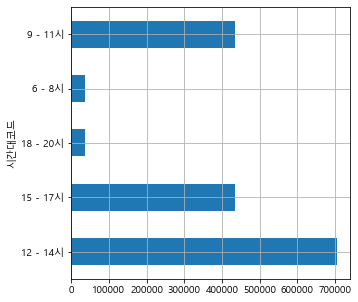

In [18]:
plt.figure()
res['총발전량'].plot(kind='barh', grid=True, figsize=(5, 5))
plt.show()

In [21]:
us_obs_energy_test = us_obs_energy.drop(['지점명', '시간'], axis=1)
us_obs_energy_test

,기온(°C),풍속(m/s),풍향(16방위),습도(%),전운량(10분위),발전량,시간대코드
0,8.9,2.8,230.0,64.0,7.0,4,6 - 8시
1,9.7,5.0,250.0,61.0,9.0,35,9 - 11시
2,9.6,4.4,290.0,64.0,8.0,71,9 - 11시
3,10.5,6.9,290.0,41.0,1.0,82,9 - 11시
4,11.2,6.1,290.0,29.0,0.0,334,12 - 14시
...,...,...,...,...,...,...,...
12108,10.9,3.4,140.0,32.0,0.0,294,12 - 14시
12109,10.6,3.9,140.0,39.0,0.0,259,15 - 17시
12110,11.3,3.2,160.0,33.0,0.0,196,15 - 17시
12111,10.3,4.0,180.0,31.0,0.0,83,15 - 17시


D:\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
D:\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)
D:\anaconda3\lib\site-packages\matplotlib\textpath.py:74: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)


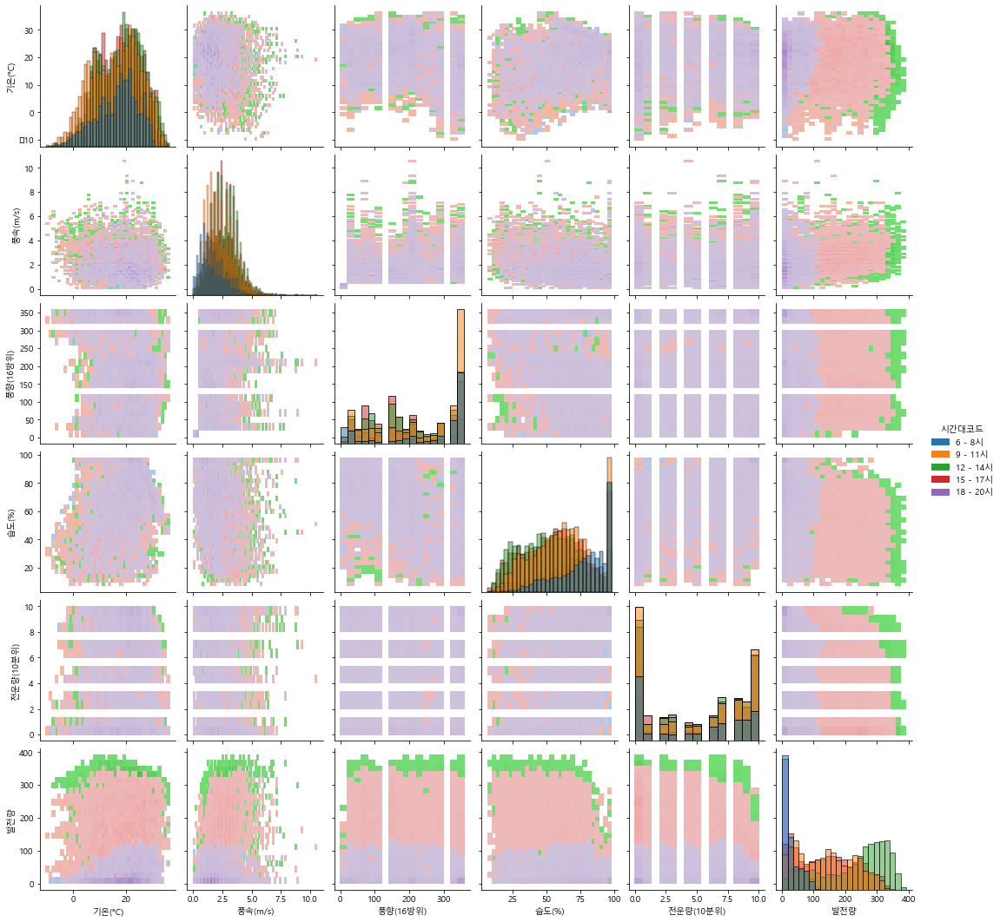

In [23]:
sns.pairplot(us_obs_energy_test, kind="hist", hue="시간대코드")
plt.show()

In [38]:
plt.rc('font', family="Malgun Gothic")
sns.countplot(x="기온(°C)", hue="시간대코드", data=us_obs_energy)
plt.show()

TypeError: bar() got multiple values for argument 'height'

In [39]:
sns.heatmap(us_obs_energy_test, annot=True, fmt="d", linewidths=1)
plt.show()

ValueError: could not convert string to float: '6 - 8시'